# Session 8: Diffusion Models for Music Generation

Agenda:
- Introduction to Diffusion Models
- Conditioning & Classifier-Free Guidance
- Hands On: Using Stable Audio

## Introduction to Diffusion Models

Image example from _developer.nvidia.com_.

![](./assets/diffusion.png)


### Some concepts

- $X_0$ is a random variable, distributed according to a distribution of interest
that admits density $p_0$.

- $X_t$ is a noisy version of $X_0$, where the noise is generated through a
noise model:

    $$
    X_t = \sqrt{1-\sigma^2_t}X_0 + \sigma_t Z, \; \; Z \sim \mathcal{N}(0, I_d)
    $$,

    where $\sigma_0=0$, $\sigma_t=\sigma(t) \in [0, 1]$ is an increasing
    function of $t$ and $\lim_{t \to \infty} \sigma(t) = 1$.

- We call $\sigma(t)$ the _noise schedule_. It can be generated by a few
different processes, e.g.:

    $$
    \sigma(t) = \sin \Big( \frac{t/T + s}{1 + s}\frac{\pi}{2} \Big)
    $$

    <center><img src="assets/cosine_noise.png" width="50%"/></center>

    In this case, we have a continuous time $t \in \mathbb{R}^+$. Some other
    models might use a finite set of noise levels with $t \in \mathbb{N}$.

### Corruption Process
 
The _corruption process_ describes how the noise is added onto our data. We can
use:

1. **Variance Exploding:** $X_t = X_0 + \sigma_t Z, \; \; \sigma_t \geq 0, \lim_{t \to \infty} \sigma_t = \infty$

2. **Variance Preserving:** $X_t = \sqrt{1-\sigma_t^2} X_0 + \sigma_t Z, \; \; 0 \leq \sigma_t \leq 1, \lim_{t \to \infty} \sigma_t = 1$

3. **Flow Matching:** $X_t = (1 - \sigma_t) X_0 + \sigma_t Z, \; \; 0 \leq \sigma_t \leq 1, \lim_{t \to \infty} \sigma_t = 1$

The corruption process can also be described by a differential equation:

$$
dX_t = f(X_t, t)dt + g(t)dB
$$,

where $f(X_t,t)$ is the "_drift_", $g(t)$ is the _diffusion coefficient_, and
$B_t$ is _Brownian noise_.

**Important:** This process is _reversible_, and we have:

$$
d\tilde{X}_t = \big( -f(\tilde{X}_t, T-t) + g^2(T-t) {\color{orange} \nabla \log p_{T-t} (\tilde{X}_t) } \big) dt + g(T-t) d\tilde{B}_t
$$,

where $X_t$ and $\tilde{X}_t$ follow the same distribution, $B_t$ and
$\tilde{B}_t$ follow the same distribution, and ${\color{orange} \nabla \log p_t(\cdot)}$
is the <span style="color: orange">**score function**</span>.

<div class="alert alert-info">

Instead of approximating $p(X)$ directly like likelihood-based models, diffusion
models try to approximate $\nabla \log p(X)$.

</div>

By moving in the direction of the score function, we can model a trajectory that
guides to a sample of $p(X_0)$.

![](./assets/sgld.png)

### The UNet Architecture

From [U-Net: Convolutional Networks for Biomedical Image Segmentation](https://arxiv.org/abs/1505.04597) and [Attention U-Net: Learning Where to Look for the Pancreas](https://arxiv.org/abs/1804.03999).

![](./assets/unets.png)

### Conditioning & Classifier-Free Guidance

From Bayes's Theorem, we have a conditional score function:

$$
\nabla \log p(X|Y) = \nabla \log p(Y|X) + \nabla \log p(X)
$$

This means that the **score function of our conditional model** is the sum of the _unconditional score function_, and a _conditioning term_. We usually scale our _conditioning term_ by a factor and get $\gamma \nabla \log p(Y|X)$.

We can either train a classifier to estimate $p(Y|X)$ (_Classifier Guidance_), or train our generative model to estimate both $p(X)$ and $p(X|Y)$ by using _conditioning dropout_, making our model capable of handling the conditioning signal when it is present. Using Bayes's Theorem, we further have that:

$$
\nabla \log p(Y|X) = \nabla \log p(X|Y) - \nabla \log p(X)
$$

Using our scaling factor, we have:

$$
\nabla \log p(X|Y) = (1-\gamma) \nabla \log p(X) + \gamma \log p(X|Y)
$$

When $\gamma = 0$, we have the unconditional model, and when $\gamma = 1$, we have the conditional model. The interesting results of CFG happen when $\gamma > 1$.

### Inference-Time Optimization: DITTO

From [DITTO: Diffusion Inference-Time T-Optimization for Music Generation](https://arxiv.org/abs/2401.12179).

![](./assets/ditto.png)

## Hands On: Using Stable Audio

<div class="alert alert-info">

**IMPORTANT:** Make sure you use the Python 3.10 venv for this Hands-On

</div>

### Using the API

In [1]:
!git clone https://github.com/Stability-AI/stable-audio-tools.git ../repositories/stable-audio-tools
!pip install ../repositories/stable-audio-tools

Cloning into '../repositories/stable-audio-tools'...
remote: Enumerating objects: 1943, done.
remote: Counting objects: 100% (1116/1116), done.
remote: Compressing objects: 100% (274/274), done.
remote: Total 1943 (delta 932), reused 842 (delta 842), pack-reused 827 (from 1)
Receiving objects: 100% (1943/1943), 558.42 KiB | 8.86 MiB/s, done.
Resolving deltas: 100% (1366/1366), done.
Processing /home/resenv/Desktop/ai_music_course/repositories/stable-audio-tools
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached einops_exts-0.0.4-py3-none-any.whl (3.9 kB)
  Using cached k_diffusion-0.1.1-py3-none-any.whl (33 kB)
  Using cached einops-0.8.1-py3-none-any.whl (64 kB)
  Using cached importlib_resources-5.12.0-py3-none-any.whl (36 kB)
  Using cached wandb-0.15.4-py3-none-any.whl (2.1 MB)
  Using cached sentencepiece-0.1.99-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.3 MB)
  Us

In [2]:
import huggingface_hub

huggingface_hub.login("HF_TOKEN")

In [1]:
import huggingface_hub
import json
import torch
from stable_audio_tools.models.factory import create_model_from_config
from stable_audio_tools.models.utils import load_ckpt_state_dict

repo_id = "stabilityai/stable-audio-open-1.0"
cache_dir = "../huggingface_hub_cache"

model_config_path = huggingface_hub.hf_hub_download(
    repo_id=repo_id,
    filename="model_config.json",
    cache_dir=cache_dir,
    force_download=False,
)

with open(model_config_path, "r") as f:
    model_config = json.load(f)

model = create_model_from_config(model_config)

model_ckpt_path = huggingface_hub.hf_hub_download(
    repo_id=repo_id,
    filename="model.safetensors",
    cache_dir=cache_dir,
    force_download=False,
)

model.load_state_dict(load_ckpt_state_dict(model_ckpt_path))

device = "cuda" if torch.cuda.is_available() else "cpu"

model.to(device).eval().requires_grad_(False)

/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


No module named 'flash_attn'
flash_attn not installed, disabling Flash Attention


/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torch/nn/utils/weight_norm.py:143: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


ConditionedDiffusionModelWrapper(
  (model): DiTWrapper(
    (model): DiffusionTransformer(
      (timestep_features): FourierFeatures()
      (to_timestep_embed): Sequential(
        (0): Linear(in_features=256, out_features=1536, bias=True)
        (1): SiLU()
        (2): Linear(in_features=1536, out_features=1536, bias=True)
      )
      (to_cond_embed): Sequential(
        (0): Linear(in_features=768, out_features=768, bias=False)
        (1): SiLU()
        (2): Linear(in_features=768, out_features=768, bias=False)
      )
      (to_global_embed): Sequential(
        (0): Linear(in_features=1536, out_features=1536, bias=False)
        (1): SiLU()
        (2): Linear(in_features=1536, out_features=1536, bias=False)
      )
      (transformer): ContinuousTransformer(
        (layers): ModuleList(
          (0-23): 24 x TransformerBlock(
            (pre_norm): LayerNorm()
            (self_attn): Attention(
              (to_qkv): Linear(in_features=1536, out_features=4608, bias=F

In [2]:
from torchinfo import summary

summary(model)

Layer (type:depth-idx)                                            Param #
ConditionedDiffusionModelWrapper                                  --
├─DiTWrapper: 1-1                                                 --
│    └─DiffusionTransformer: 2-1                                  --
│    │    └─FourierFeatures: 3-1                                  (128)
│    │    └─Sequential: 3-2                                       (2,755,584)
│    │    └─Sequential: 3-3                                       (1,179,648)
│    │    └─Sequential: 3-4                                       (4,718,592)
│    │    └─ContinuousTransformer: 3-5                            (1,048,166,400)
│    │    └─Conv1d: 3-6                                           (4,096)
│    │    └─Conv1d: 3-7                                           (4,096)
├─MultiConditioner: 1-2                                           --
│    └─ModuleDict: 2-2                                            --
│    │    └─T5Conditioner: 3-8               

In [3]:
import numpy as np
from stable_audio_tools.inference.generation import generate_diffusion_cond

sample_length = 10
sample_size = model.sample_rate * sample_length
conditioning = [{ "prompt": "70s rock with bright electric guitar and drums", "seconds_start": 0, "seconds_total": sample_length }]
seed = np.random.randint(0, 2**32 - 1, dtype=np.uint32)

generate_args = {
    "model": model,
    "conditioning": conditioning,
    "negative_conditioning": None,
    "steps": 250,
    "cfg_scale": 6.0,
    "cfg_interval": (0.0, 1.0),
    "batch_size": 1,
    "sample_size": sample_size,
    "seed": seed,
    "device": device,
    "sampler_type": "dpmpp-3m-sde",
    "sigma_min": 0.03,
    "sigma_max": 1000,
    "init_audio": None,
    "init_noise_level": 1.0,
    "callback": None,
    "scale_phi": 0.0,
    "rho": 1.0
}

audio = generate_diffusion_cond(**generate_args)

1223675342


/home/resenv/Desktop/stable-audio-tools/stable_audio_tools/models/conditioners.py:362: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(dtype=torch.float16) and torch.set_grad_enabled(self.enable_grad):
  0%|          | 0/250 [00:00<?, ?it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:608: UserWarning: Should have tb<=t1 but got tb=1000.0001220703125 and t1=1000.000122.
  warnings.warn(f"Should have {tb_name}<=t1 but got {tb_name}={tb} and t1={self._end}.")
 98%|█████████▊| 245/250 [00:07<00:00, 33.49it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.029999999329447746 and t0=0.03.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 250/250 [00:07<00:00, 

In [4]:
from IPython.display import Audio, display

display(Audio(audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

In [5]:
import librosa

y, sr = librosa.load("../session2_setup/assets/stargazing.wav", sr=model.sample_rate)

display(Audio(y, rate=sr))

input_audio = torch.from_numpy(y).to(device)

sample_length = input_audio.shape[-1] / sr
sample_size = int(model.sample_rate * sample_length)
conditioning = [{ "prompt": "disco track with catchy bassline", "seconds_start": 0, "seconds_total": sample_length }]
seed = np.random.randint(0, 2**32 - 1, dtype=np.uint32)

generate_args = {
    "model": model,
    "conditioning": conditioning,
    "negative_conditioning": None,
    "steps": 250,
    "cfg_scale": 6.0,
    "cfg_interval": (0.0, 1.0),
    "batch_size": 1,
    "sample_size": sample_size,
    "seed": seed,
    "device": device,
    "sampler_type": "dpmpp-3m-sde",
    "sigma_min": 0.03,
    "sigma_max": 1000,
    "init_audio": (sr, input_audio.unsqueeze(0)),
    "init_noise_level": 2.0,
    "callback": None,
    "scale_phi": 0.0,
    "rho": 1.0
}

cond_audio = generate_diffusion_cond(**generate_args)

/home/resenv/Desktop/stable-audio-tools/stable_audio_tools/models/conditioners.py:362: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(dtype=torch.float16) and torch.set_grad_enabled(self.enable_grad):


2446461874


 98%|█████████▊| 246/250 [00:11<00:00, 21.30it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.029999999329447746 and t0=0.03.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 250/250 [00:11<00:00, 21.15it/s]


In [6]:
display(Audio(cond_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

### Deeper Dive

In [26]:
# We will be using the downsampled latent size
latent_size = sample_size // model.pretransform.downsampling_ratio

# Set the seed for noise
seed = np.random.randint(0, 2**32 - 1, dtype=np.uint32)
torch.manual_seed(seed)

# Define the latent noise
noise = torch.randn((1, model.io_channels, latent_size), device=device)
print(noise.shape)

torch.Size([1, 64, 322])


In [27]:
# Some config

torch.backends.cuda.matmul.allow_tf32 = False
torch.backends.cudnn.allow_tf32 = False
torch.backends.cuda.matmul.allow_fp16_reduced_precision_reduction = False
torch.backends.cudnn.benchmark = False

In [28]:
# Inspecting the conditioner

print(model.conditioner)

MultiConditioner(
  (conditioners): ModuleDict(
    (prompt): T5Conditioner(
      (proj_out): Identity()
    )
    (seconds_start): NumberConditioner(
      (proj_out): Identity()
      (embedder): NumberEmbedder(
        (embedding): Sequential(
          (0): LearnedPositionalEmbedding()
          (1): Linear(in_features=257, out_features=768, bias=True)
        )
      )
    )
    (seconds_total): NumberConditioner(
      (proj_out): Identity()
      (embedder): NumberEmbedder(
        (embedding): Sequential(
          (0): LearnedPositionalEmbedding()
          (1): Linear(in_features=257, out_features=768, bias=True)
        )
      )
    )
  )
)


In [29]:
# We create the conditioning tensors with the model's conditioner
conditioning_tensors = model.conditioner(conditioning, device)

print(conditioning_tensors["prompt"])
print("Shape of prompt embedding: ", conditioning_tensors["prompt"][0].shape)
print("Shape of seconds_start embedding: ", conditioning_tensors["seconds_start"][0].shape)
print("Shape of seconds_total embedding: ", conditioning_tensors["seconds_total"][0].shape)
# conditioning_tensors["prompt"]

(tensor([[[ 0.0441, -0.0817,  0.4272,  ...,  0.0737, -0.0217, -0.3167],
         [-0.0041, -0.4219, -0.0033,  ...,  0.0242, -0.7383, -0.0570],
         [-0.3787,  0.1196,  0.3137,  ..., -0.1478, -0.2205, -0.2859],
         ...,
         [-0.0000, -0.0000, -0.0000,  ...,  0.0000,  0.0000, -0.0000],
         [-0.0000, -0.0000, -0.0000,  ...,  0.0000,  0.0000, -0.0000],
         [-0.0000, -0.0000, -0.0000,  ...,  0.0000,  0.0000, -0.0000]]],
       device='cuda:0'), tensor([[ True,  True,  True,  True,  True,  True,  True,  True,  True, False,
         False, False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, 

/home/resenv/Desktop/stable-audio-tools/stable_audio_tools/models/conditioners.py:362: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(dtype=torch.float16) and torch.set_grad_enabled(self.enable_grad):


In [30]:
# We build the cross attention conditioning inputs and the global conditioning
# inputs
conditioning_inputs = model.get_conditioning_inputs(conditioning_tensors)

print(conditioning_inputs)
print("Shape of the cross attention conditioning inputs: ", conditioning_inputs["cross_attn_cond"].shape)
print("Shape of the global conditioning inputs: ", conditioning_inputs["global_cond"].shape)

{'cross_attn_cond': tensor([[[ 0.0441, -0.0817,  0.4272,  ...,  0.0737, -0.0217, -0.3167],
         [-0.0041, -0.4219, -0.0033,  ...,  0.0242, -0.7383, -0.0570],
         [-0.3787,  0.1196,  0.3137,  ..., -0.1478, -0.2205, -0.2859],
         ...,
         [-0.0000, -0.0000, -0.0000,  ...,  0.0000,  0.0000, -0.0000],
         [ 0.0107, -0.1556, -0.0316,  ...,  0.0149, -0.0154,  0.0076],
         [ 0.0323, -0.0845, -0.0408,  ..., -0.0238, -0.3308,  0.0372]]],
       device='cuda:0'), 'cross_attn_mask': tensor([[1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        

In [31]:
# What features are used for the conditioning?
print("Features used for cross attention:", model.cross_attn_cond_ids)
print("Features used for global conditioning:", model.global_cond_ids)

Features used for cross attention: ['prompt', 'seconds_start', 'seconds_total']
Features used for global conditioning: ['seconds_start', 'seconds_total']


In [32]:
from stable_audio_tools.inference.utils import prepare_audio

io_channels = model.pretransform.io_channels

init_audio = prepare_audio(
    input_audio.unsqueeze(0),
    in_sr=sr, 
    target_sr=model.sample_rate, 
    target_length=sample_size, 
    target_channels=model.pretransform.io_channels, 
    device=device
)

encoded_audio = model.pretransform.encode(init_audio)
print("Encoded audio shape: ", encoded_audio.shape)

Encoded audio shape:  torch.Size([1, 64, 322])


In [34]:
import k_diffusion as K

denoiser = K.external.VDenoiser(model.model)

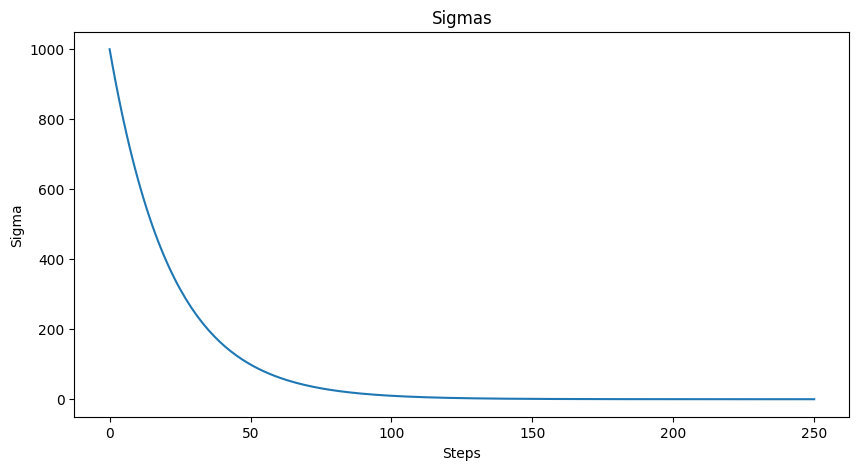

In [35]:
import matplotlib.pyplot as plt

# Let's use the noise schedule and plot the sigmas

sigmas = K.sampling.get_sigmas_polyexponential(
    250, # steps
    sigma_min=0.01,
    sigma_max=1000,
    rho=1.0,
    device=device
)

# Scale the initial noise by the first sigma
final_noise = noise * sigmas[0]

# Add the encoded audio to the noise
final_noise = encoded_audio + final_noise

plt.figure(figsize=(10, 5))

plt.plot(sigmas.cpu().numpy())
plt.title("Sigmas")
plt.xlabel("Steps")
plt.ylabel("Sigma")

plt.show()

In [36]:
extra_args = {
    "cfg_interval": (0.0, 1.0),
    "scale_phi": 0.0,
    "cross_attn_cond": conditioning_inputs["cross_attn_cond"],
    "cross_attn_mask": conditioning_inputs["cross_attn_mask"],
    "global_cond": conditioning_inputs["global_cond"],
    "cfg_scale": 6.0,
    "batch_cfg": True,
    "rescale_cfg": True
}

# Use dpmpp-3m-sde to sample the noise
sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    final_noise,
    sigmas,
    disable=False,
    extra_args=extra_args
)

 98%|█████████▊| 246/250 [00:11<00:00, 21.29it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.009999999776482582 and t0=0.01.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 250/250 [00:11<00:00, 20.96it/s]


In [37]:
# Decode the sampled audio
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

In [39]:
# Let's play around with things!
# First, let's look at different noise levels (0, 50, 100, 150, 200, 250)

decoded_audio = model.pretransform.decode(final_noise)
display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    sigmas[:50],
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    sigmas[:100],
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    sigmas[:150],
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    sigmas[:200],
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    sigmas[:250],
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

100%|██████████| 49/49 [00:02<00:00, 20.64it/s]


100%|██████████| 99/99 [00:04<00:00, 20.70it/s]


100%|██████████| 149/149 [00:07<00:00, 20.71it/s]


 99%|█████████▉| 198/199 [00:09<00:00, 20.80it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.10092898458242416 and t0=0.100929.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 199/199 [00:09<00:00, 20.53it/s]


 99%|█████████▉| 246/249 [00:11<00:00, 21.13it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.009999999776482582 and t0=0.01.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 249/249 [00:11<00:00, 20.82it/s]


In [40]:
# Let's experiment with a linear noise schedule
linear_sigmas = torch.linspace(1000, 0.01, 250)

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    noise,
    linear_sigmas,
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

 99%|█████████▉| 246/249 [00:11<00:00, 21.58it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.009999999776482582 and t0=0.01.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 249/249 [00:11<00:00, 21.57it/s]


In [43]:
# How about starting with the input audio directly?

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    encoded_audio * sigmas[0],
    sigmas,
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

  0%|          | 0/250 [00:00<?, ?it/s]

 98%|█████████▊| 246/250 [00:11<00:00, 21.18it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.009999999776482582 and t0=0.01.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 250/250 [00:11<00:00, 20.89it/s]


In [44]:
# Let's work with less steps

sigmas_20 = K.sampling.get_sigmas_polyexponential(
    20,
    sigma_min=0.01,
    sigma_max=1000,
    rho=1.0,
    device=device
)

sampled = K.sampling.sample_dpmpp_3m_sde(
    denoiser,
    encoded_audio * sigmas_20[0],
    sigmas_20,
    disable=False,
    extra_args=extra_args
)
decoded_audio = model.pretransform.decode(sampled)

display(Audio(decoded_audio.squeeze(0).cpu().numpy(), rate=model.sample_rate))

 90%|█████████ | 18/20 [00:00<00:00, 20.85it/s]/home/resenv/Desktop/stable-audio-tools/.venv/lib/python3.10/site-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.009999999776482582 and t0=0.01.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")
100%|██████████| 20/20 [00:00<00:00, 20.86it/s]
